# The Single-Cell Spatial Transcriptomics Analysis (ScSTA) Cookbook

```
Arun Das
Postdoctoral Associate
Hillman Cancer Center
University of Pittsburgh Medical Center
---
ard212@pitt.edu
https://www.linkedin.com/in/arun-das/
```

## NanoString CosMx - Non-Small Cell Lung Cancer Dataset

## Install packages

## Import packages

In [3]:
%matplotlib inline
import warnings
# Suppress all warnings
warnings.filterwarnings('ignore')

import os
import requests
import matplotlib.pyplot as plt
import seaborn as sns

from pathlib import Path
import scanpy as sc
import numpy as np
import squidpy as sq
import pandas as pd

from sklearn.neighbors import NearestNeighbors
from datetime import datetime
import anndata
from sklearn.cluster import KMeans
import monkeybread as mb 
import gseapy as gp
from gseapy.plot import barplot

import tqdm as notebook_tqdm

pd.set_option("display.max_columns", None)

# Plotting options, change to your liking
sc.settings.set_figure_params(dpi=80, frameon=False, facecolor="white")
sc.set_figure_params(dpi=80)
sc.set_figure_params(figsize=(4, 4))
sc.settings.verbosity = 0

### https://nanostring.com/products/cosmx-spatial-molecular-imager/nsclc-ffpe-dataset/

In [9]:
nanostring_dir = Path().resolve() / "tutorial_data"
sample_dir = nanostring_dir / "Lung9_Rep1" / "Lung9_Rep1-Flat_files_and_images"

adata = sq.read.nanostring(
    path=sample_dir,
    counts_file="Lung9_Rep1_exprMat_file.csv",
    meta_file="Lung9_Rep1_metadata_file.csv",
    fov_file="Lung9_Rep1_fov_positions_file.csv",
)

In [10]:
adata

AnnData object with n_obs × n_vars = 91972 × 980
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_fov'

In [11]:
adata.obs

,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.CD3,Max.CD3,Mean.DAPI,Max.DAPI,cell_ID
1_1,1,1492,1.80,1760.333333,140388.555556,54,30,8246,12492,794,1892,209,1155,380,998,310,1298,1
2_1,1,4191,2.20,1913.333333,140378.555556,112,51,7377,16475,4133,13419,100,7803,79,335,332,942,2
3_1,1,4566,0.97,2157.333333,140364.555556,76,78,9058,13283,700,3906,116,1023,175,751,443,1814,3
4_1,1,4288,1.48,2350.333333,140372.555556,92,62,8677,12168,702,1921,125,1144,297,1292,643,1467,4
5_1,1,1118,1.52,2483.333333,140387.555556,50,33,9498,12022,678,5281,103,962,297,901,386,1005,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4048_20,20,1665,1.61,21780.000000,151375.555556,61,38,11185,24445,2597,12112,191,454,92,444,339,925,4048
4049_20,20,1957,1.79,22551.000000,151376.555556,70,39,8754,26648,1499,6045,170,491,66,377,409,1033,4049
4050_20,20,1312,1.29,22803.000000,151374.555556,45,35,7440,20598,1285,3026,158,438,70,344,448,855,4050
4051_20,20,891,1.45,22157.000000,151371.555556,42,29,10534,24978,2696,6279,157,498,62,281,183,702,4051


In [12]:
adata.obs['tissue'] = "Lung9_Rep1"

In [13]:
adata.obs.head()

,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.CD3,Max.CD3,Mean.DAPI,Max.DAPI,cell_ID,tissue
1_1,1,1492,1.80,1760.333333,140388.555556,54,30,8246,12492,794,1892,209,1155,380,998,310,1298,1,Lung9_Rep1
2_1,1,4191,2.20,1913.333333,140378.555556,112,51,7377,16475,4133,13419,100,7803,79,335,332,942,2,Lung9_Rep1
3_1,1,4566,0.97,2157.333333,140364.555556,76,78,9058,13283,700,3906,116,1023,175,751,443,1814,3,Lung9_Rep1
4_1,1,4288,1.48,2350.333333,140372.555556,92,62,8677,12168,702,1921,125,1144,297,1292,643,1467,4,Lung9_Rep1
5_1,1,1118,1.52,2483.333333,140387.555556,50,33,9498,12022,678,5281,103,962,297,901,386,1005,5,Lung9_Rep1


## Cell Typing

We have to carry out cell typing on this dataset. This can be achieved using several methods including:
1. Marker-based approach
2. Reference profile-based approach (https://github.com/Nanostring-Biostats/InSituType).
3. Mapping scRNA-seq reference data to SRT data.

Nanostring's CosMx sample datasets broadly use the InSituType algorithm. We'll load the availablde cell types for now. But please refer to the paper for more info.

## Load the cell type information for the NSCLC sample

In [14]:
df = pd.read_csv(f'{sample_dir}/Lung9_Rep1_ctypes.csv', index_col=0)
df.index = [f'{str(c)}_{str(fov)}' for c,fov in zip(df['cell_ID'], df['fov'])]
df

,fov,Area,AspectRatio,Width,Height,cell_ID,cell_type
2_1,1,4191,2.20,112,51,2,tumor 9
3_1,1,4566,0.97,76,78,3,epithelial
4_1,1,4288,1.48,92,62,4,neutrophil
6_1,1,1708,1.33,56,42,6,neutrophil
7_1,1,2562,0.95,57,60,7,neutrophil
...,...,...,...,...,...,...,...
4048_20,20,1665,1.61,61,38,4048,tumor 9
4049_20,20,1957,1.79,70,39,4049,tumor 9
4050_20,20,1312,1.29,45,35,4050,tumor 9
4051_20,20,891,1.45,42,29,4051,tumor 9


## Combine the cell type information with the gene expressions

In [15]:
adata_ctype = pd.merge(adata.obs, df['cell_type'], how='outer', right_index=True, left_index=True)
adata_ctype = adata_ctype.drop_duplicates()
adata_ctype['cell_type'].fillna('unknown', inplace=True)
adata_ctype.replace({k:'tumor' for k in ['tumor '+ str(i) for i in [5, 6, 9, 12, 13]]}, inplace=True)
adata_ctype = adata_ctype.loc[adata.obs.index]

for column_name in adata_ctype.columns:
    if column_name in adata.obs.columns:
        new_dtype = adata.obs[column_name].dtype
        adata_ctype[column_name] = adata.obs[column_name].astype(new_dtype)
        
adata.obs = adata_ctype

In [16]:
adata.obs

,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.CD3,Max.CD3,Mean.DAPI,Max.DAPI,cell_ID,tissue,cell_type
1_1,1,1492,1.80,1760.333333,140388.555556,54,30,8246,12492,794,1892,209,1155,380,998,310,1298,1,Lung9_Rep1,unknown
2_1,1,4191,2.20,1913.333333,140378.555556,112,51,7377,16475,4133,13419,100,7803,79,335,332,942,2,Lung9_Rep1,tumor
3_1,1,4566,0.97,2157.333333,140364.555556,76,78,9058,13283,700,3906,116,1023,175,751,443,1814,3,Lung9_Rep1,epithelial
4_1,1,4288,1.48,2350.333333,140372.555556,92,62,8677,12168,702,1921,125,1144,297,1292,643,1467,4,Lung9_Rep1,neutrophil
5_1,1,1118,1.52,2483.333333,140387.555556,50,33,9498,12022,678,5281,103,962,297,901,386,1005,5,Lung9_Rep1,unknown
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4048_20,20,1665,1.61,21780.000000,151375.555556,61,38,11185,24445,2597,12112,191,454,92,444,339,925,4048,Lung9_Rep1,tumor
4049_20,20,1957,1.79,22551.000000,151376.555556,70,39,8754,26648,1499,6045,170,491,66,377,409,1033,4049,Lung9_Rep1,tumor
4050_20,20,1312,1.29,22803.000000,151374.555556,45,35,7440,20598,1285,3026,158,438,70,344,448,855,4050,Lung9_Rep1,tumor
4051_20,20,891,1.45,22157.000000,151371.555556,42,29,10534,24978,2696,6279,157,498,62,281,183,702,4051,Lung9_Rep1,tumor


In [17]:
adata

AnnData object with n_obs × n_vars = 91972 × 980
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'tissue', 'cell_type'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_fov'

In [18]:
adata.obs['cell_type'].unique()

array(['unknown', 'tumor', 'epithelial', 'neutrophil', 'fibroblast',
       'endothelial', 'T CD8 memory', 'B-cell', 'T CD4 memory',
       'T CD4 naive', 'NK', 'monocyte', 'macrophage', 'plasmablast',
       'Treg', 'T CD8 naive', 'mDC', 'pDC', 'mast'], dtype=object)

## Quality Control

In [19]:
adata.var["NegPrb"] = adata.var_names.str.startswith("NegPrb")
sc.pp.calculate_qc_metrics(adata, qc_vars=["NegPrb"], inplace=True)

In [20]:
adata = adata[:, ~adata.var_names.str.startswith("NegPrb")]

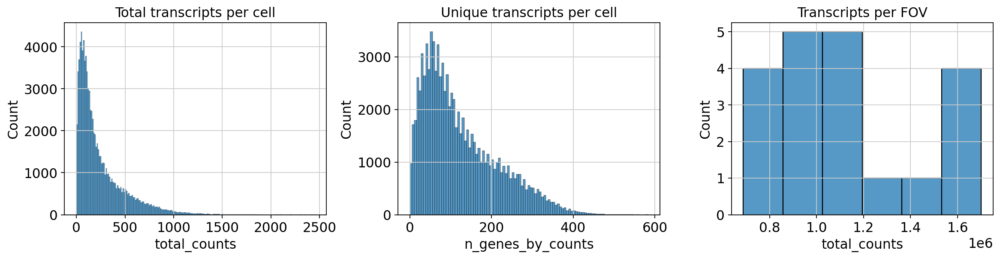

In [21]:
fig, axs = plt.subplots(1, 3, figsize=(15, 4))

axs[0].set_title("Total transcripts per cell")
sns.histplot(
    adata.obs["total_counts"],
    kde=False,
    ax=axs[0],
)

axs[1].set_title("Unique transcripts per cell")
sns.histplot(
    adata.obs["n_genes_by_counts"],
    kde=False,
    ax=axs[1],
)

axs[2].set_title("Transcripts per FOV")
sns.histplot(
    adata.obs.groupby("fov")["total_counts"].sum(),
    kde=False,
    ax=axs[2],
)

plt.tight_layout()

## Morphology Image Summary

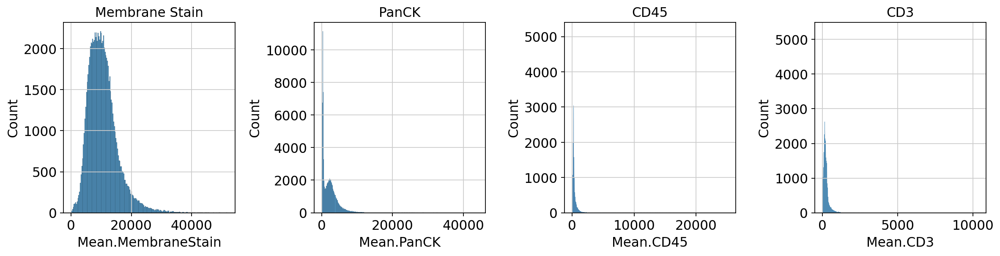

In [22]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))

axs[0].set_title("Membrane Stain")
sns.histplot(
    adata.obs["Mean.MembraneStain"],
    kde=False,
    ax=axs[0],
)

axs[1].set_title("PanCK")
sns.histplot(
    adata.obs["Mean.PanCK"],
    kde=False,
    ax=axs[1],
)

axs[2].set_title("CD45")
sns.histplot(
    adata.obs["Mean.CD45"],
    kde=False,
    ax=axs[2],
)

axs[3].set_title("CD3")
sns.histplot(
    adata.obs["Mean.CD3"],
    kde=False,
    ax=axs[3],
)

plt.tight_layout()

## Filter the cells and genes

In [23]:
sc.pp.filter_cells(adata, min_counts=100)
sc.pp.filter_genes(adata, min_cells=100)

In [24]:
adata.obs

,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.CD3,Max.CD3,Mean.DAPI,Max.DAPI,cell_ID,tissue,cell_type,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_NegPrb,log1p_total_counts_NegPrb,pct_counts_NegPrb,n_counts
9_1,1,3431,2.22,2964.333333,140380.555556,102,46,7506,11281,1855,7376,145,819,107,340,380,1222,9,Lung9_Rep1,tumor,103,4.644391,131,4.882802,59.541985,97.709924,100.0,100.0,0,0.000000,0.000000,131
10_1,1,2240,1.26,3334.333333,140378.555556,63,50,9750,13472,1950,7221,131,1048,76,261,697,1598,10,Lung9_Rep1,tumor,122,4.812184,200,5.303305,64.000000,89.000000,100.0,100.0,0,0.000000,0.000000,200
11_1,1,1883,1.56,3397.333333,140381.555556,70,45,9772,18072,1734,6853,409,1969,106,298,446,1198,11,Lung9_Rep1,tumor,94,4.553877,129,4.867534,65.891473,100.000000,100.0,100.0,0,0.000000,0.000000,129
15_1,1,3494,1.52,5192.333333,140373.555556,91,60,8333,13351,2830,7590,197,925,109,356,334,1143,15,Lung9_Rep1,tumor,154,5.043425,275,5.620401,60.363636,80.363636,100.0,100.0,0,0.000000,0.000000,275
16_1,1,1927,1.28,5451.333333,140380.555556,59,46,9181,13267,3950,10967,412,4549,130,809,167,875,16,Lung9_Rep1,tumor,94,4.553877,127,4.852030,65.354331,100.000000,100.0,100.0,1,0.693147,0.787402,126
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4045_20,20,5545,2.80,19065.000000,151382.555556,143,51,6587,14048,2958,18370,208,505,99,408,265,937,4045,Lung9_Rep1,tumor,143,4.969813,301,5.710427,65.448505,85.714286,100.0,100.0,0,0.000000,0.000000,301
4046_20,20,2909,1.78,22010.000000,151381.555556,87,49,8689,24962,1577,8804,218,618,90,522,384,912,4046,Lung9_Rep1,tumor,159,5.075174,281,5.641907,59.074733,79.003559,100.0,100.0,1,0.693147,0.355872,280
4048_20,20,1665,1.61,21780.000000,151375.555556,61,38,11185,24445,2597,12112,191,454,92,444,339,925,4048,Lung9_Rep1,tumor,111,4.718499,157,5.062595,61.146497,92.993631,100.0,100.0,0,0.000000,0.000000,157
4049_20,20,1957,1.79,22551.000000,151376.555556,70,39,8754,26648,1499,6045,170,491,66,377,409,1033,4049,Lung9_Rep1,tumor,89,4.499810,124,4.828314,68.548387,100.000000,100.0,100.0,0,0.000000,0.000000,124


In [25]:
adata

AnnData object with n_obs × n_vars = 60114 × 960
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'tissue', 'cell_type', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_counts'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_fov'

In [26]:
selected_fovs = [f"{i}" for i in [17, 18, 19, 13, 14, 15]]

## Spatial plot of cell types (with cell segmentations)

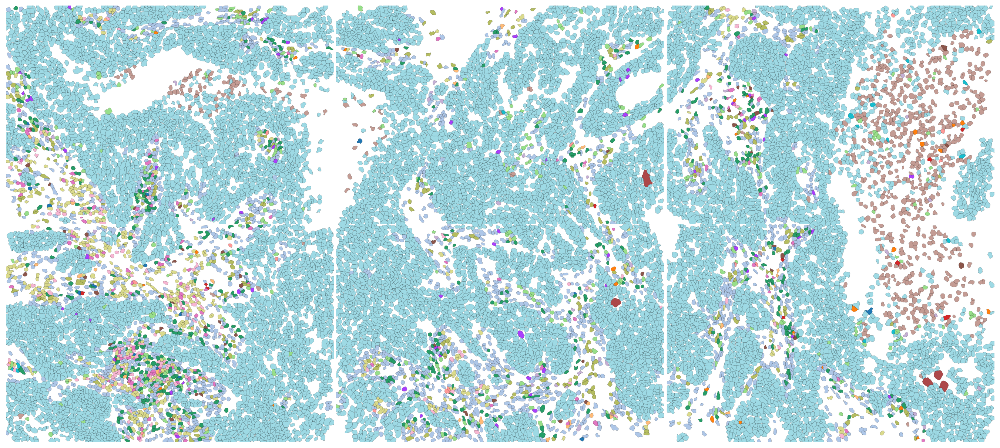

In [27]:
plot_focus = "cell_type"

axs_scatter = sq.pl.spatial_segment(
    adata,
    color=plot_focus,
    library_key="fov",
    library_id = selected_fovs,
    seg_cell_id="cell_ID", 
    seg_outline = True,
    # palette='tab20',
    img=False,
    colorbar=False,
    hspace=0, wspace=0,
    ncols=3,
    legend_loc=None,
    outline=False,
    axis_label = None,
    figsize=(7,4.5),
    # library_first=True,
    frameon=False,
    title=None,
    return_ax = True
)

# Get the current Matplotlib axes object
for ax in axs_scatter:    
    # Remove the title from the Matplotlib axes
    ax.set_title("")

# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0.0001, wspace=0.0001)

# Optionally, tighten the layout
# plt.tight_layout()

# plt.savefig(os.path.join(sample_dir, 'generated_figures', f'whole_tissue_{plot_focus}.png'), dpi=200)
# Show or save the plot
plt.show()

In [28]:
adata

AnnData object with n_obs × n_vars = 60114 × 960
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'tissue', 'cell_type', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_counts'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'spatial', 'cell_type_colors'
    obsm: 'spatial', 'spatial_fov'

## Subset the AnnData object

In [29]:
adata = adata[adata.obs['fov'].isin(selected_fovs)]

## Spatial plot of cell types (2D scatter plot)

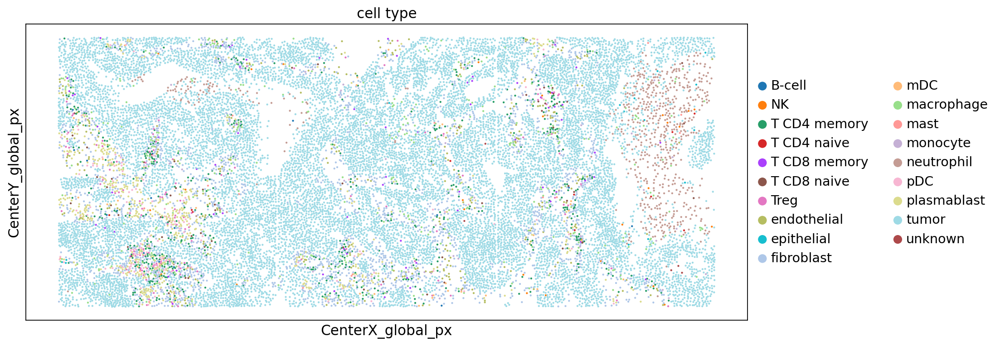

In [30]:
fig, ax = plt.subplots(1, 1, figsize=(14, 5))

# Create the scatter plot without grid lines
ax = sc.pl.scatter(
    adata,
    x='CenterX_global_px',
    y='CenterY_global_px',
    color='cell_type',
    show=False, 
    size=15,
    frameon=False, 
    ax=ax
    # legend_loc='none'
)

# Turn off x and y axes
ax.set_xticks([])
ax.set_yticks([])

plt.tight_layout()

os.makedirs(os.path.join(sample_dir, 'generated_figures'), exist_ok=True)
plt.savefig(os.path.join(sample_dir, 'generated_figures', f'scatter_plot_celltypes.png'), dpi=200)

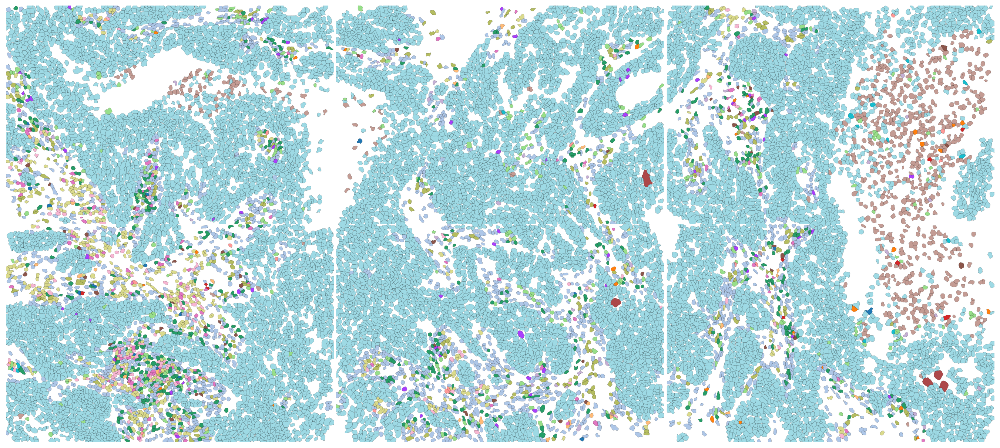

In [31]:
plot_focus = "cell_type"

axs_scatter = sq.pl.spatial_segment(
    adata,
    color=plot_focus,
    library_key="fov",
    library_id = selected_fovs,
    seg_cell_id="cell_ID", 
    seg_outline = True,
    # palette='tab20',
    img=False,
    colorbar=False,
    hspace=0, wspace=0,
    ncols=3,
    legend_loc=None,
    outline=False,
    axis_label = None,
    figsize=(7,4.5),
    # library_first=True,
    frameon=False,
    title=None,
    return_ax = True
)

# Get the current Matplotlib axes object
for ax in axs_scatter:    
    # Remove the title from the Matplotlib axes
    ax.set_title("")

# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0.0001, wspace=0.0001)

# Optionally, tighten the layout
# plt.tight_layout()

# plt.savefig(os.path.join(sample_dir, 'generated_figures', f'whole_tissue_{plot_focus}.png'), dpi=200)
# Show or save the plot
plt.show()

## Carry out Preprocessing

In [32]:
adata.layers["counts"] = adata.X.copy()

### Normalize the data based on the total reads

In [33]:
sc.pp.normalize_total(adata)

### Log normalize the dataset

In [34]:
sc.pp.log1p(adata)

### Find the highly variable genes

In [35]:
sc.pp.highly_variable_genes(adata)

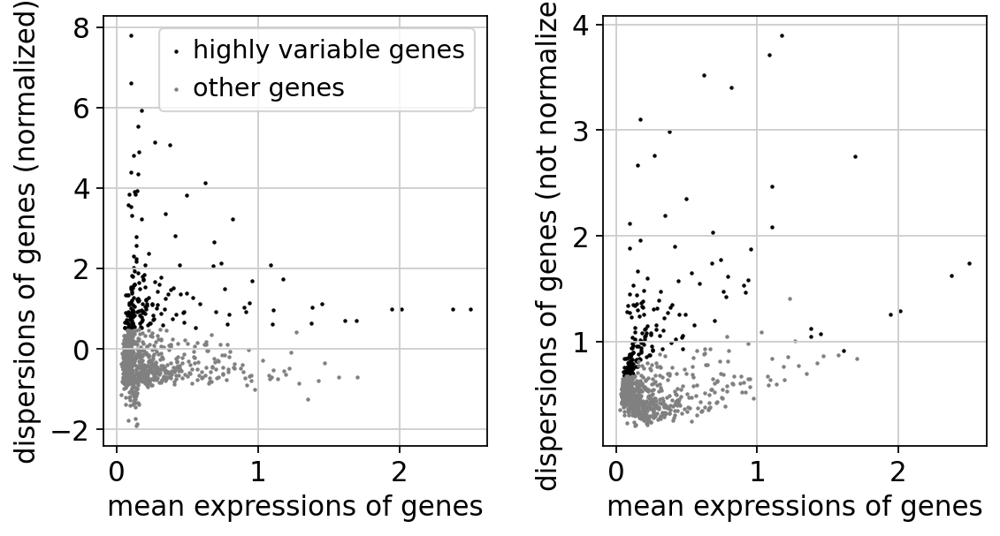

In [36]:
sc.pl.highly_variable_genes(adata)

### Carry out PCA to reduce the dimensions of the dataset

In [37]:
sc.pp.pca(adata, svd_solver='arpack')

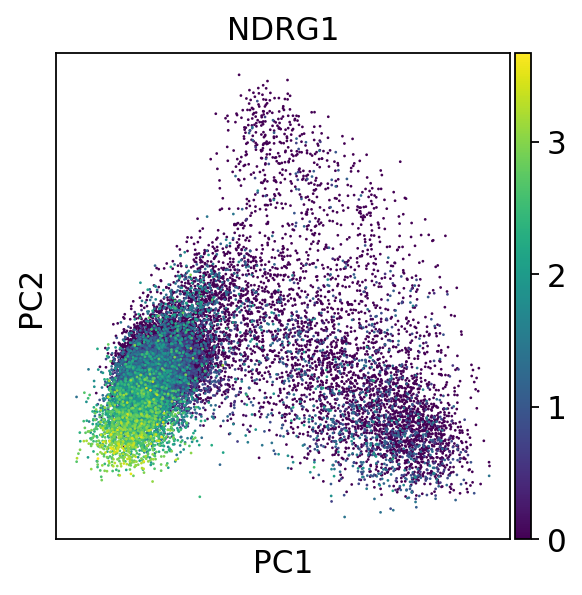

In [38]:
sc.pl.pca(adata, color='NDRG1')

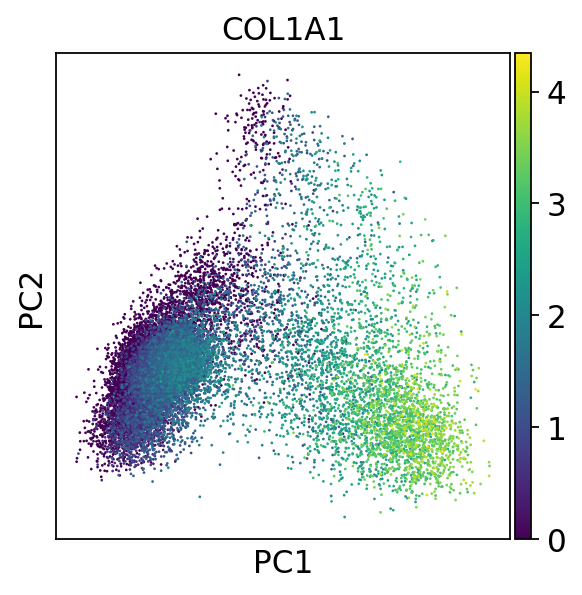

In [39]:
sc.pl.pca(adata, color='COL1A1')

### Compute the neighborhood graph

In [40]:
%%time
sc.pp.neighbors(adata, n_neighbors=100)

CPU times: user 46.2 s, sys: 1.77 s, total: 47.9 s
Wall time: 50.6 s


In [41]:
adata

AnnData object with n_obs × n_vars = 19873 × 960
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'tissue', 'cell_type', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_counts'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'spatial', 'cell_type_colors', 'log1p', 'hvg', 'pca', 'neighbors'
    obsm: 'spatial', 'spatial_fov', 'X_pca'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'di

### Compute the UMAP

In [42]:
%%time
sc.tl.umap(adata)

CPU times: user 36.6 s, sys: 363 ms, total: 37 s
Wall time: 34.4 s


### Cluster the UMAP

#### We can use any clustering algorithms here. Two of the most popular are Leiden and Louvain.

In [43]:
%%time
sc.tl.louvain(adata)

CPU times: user 22.8 s, sys: 482 ms, total: 23.3 s
Wall time: 23.2 s


In [44]:
%%time
sc.tl.leiden(adata)

CPU times: user 53.3 s, sys: 747 ms, total: 54.1 s
Wall time: 54 s


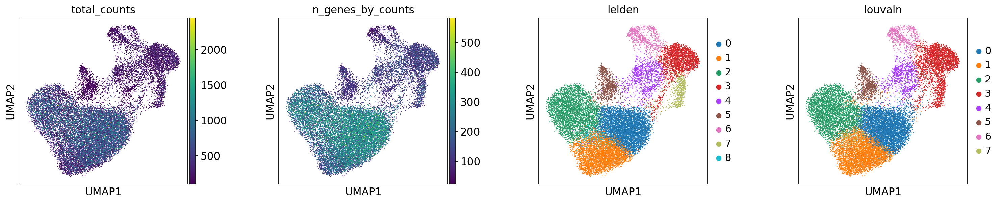

In [45]:
sc.pl.umap(
    adata,
    color=[
        "total_counts",
        "n_genes_by_counts",
        "leiden",
        "louvain",
    ],
    wspace=0.4,
)

## Plot the UMAP and paint each cell by the cell-type

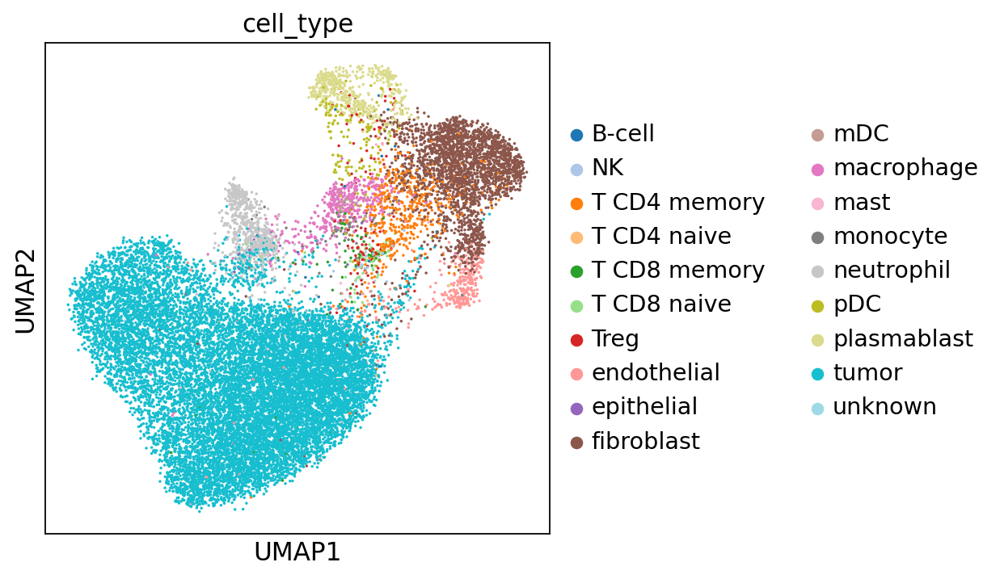

In [46]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
dotsize = 10

sc.pl.umap(
    adata,
    color=[
        'cell_type'
    ], size=dotsize,
    wspace=0.4, ax=ax, palette='tab20'
)


## Plot T-cells in the UMAP

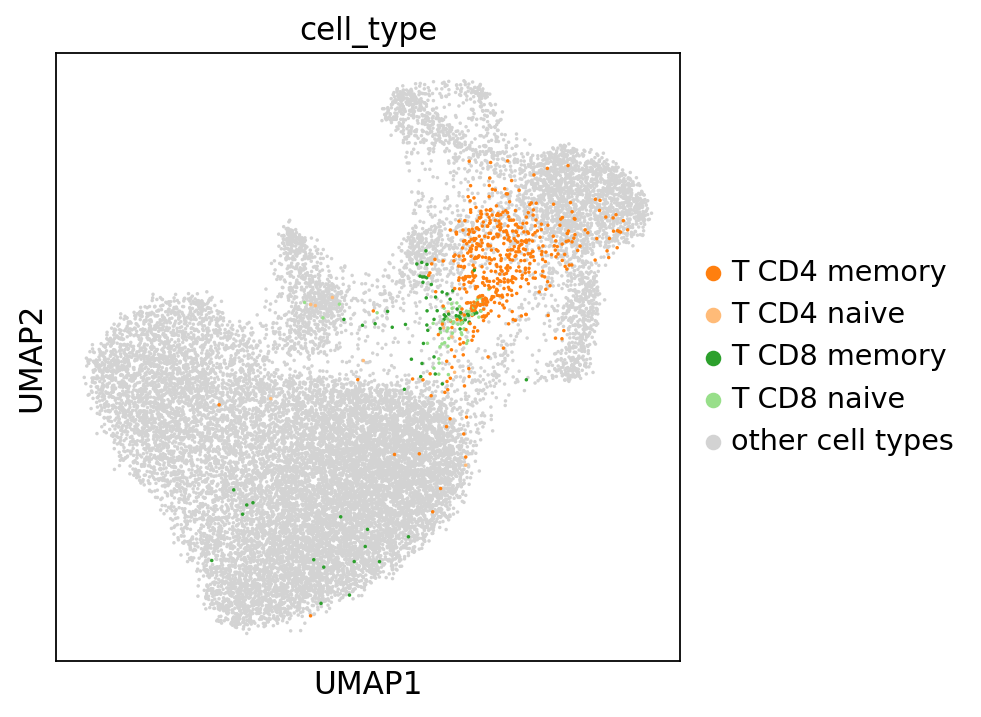

In [47]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
dotsize = 10
ax = sc.pl.umap(adata, color=['cell_type'], groups=["T CD4 memory", "T CD4 naive", "T CD8 memory", "T CD8 naive"], show=False, size=dotsize, ax=ax)

# We can change the 'NA' in the legend that represents all cells outside of the
# specified groups
legend_texts=ax.get_legend().get_texts()
# Find legend object whose text is "NA" and change it
for legend_text in legend_texts:
    if legend_text.get_text()=="NA":
        legend_text.set_text('other cell types')

## Plot gene expressions of tumor cells

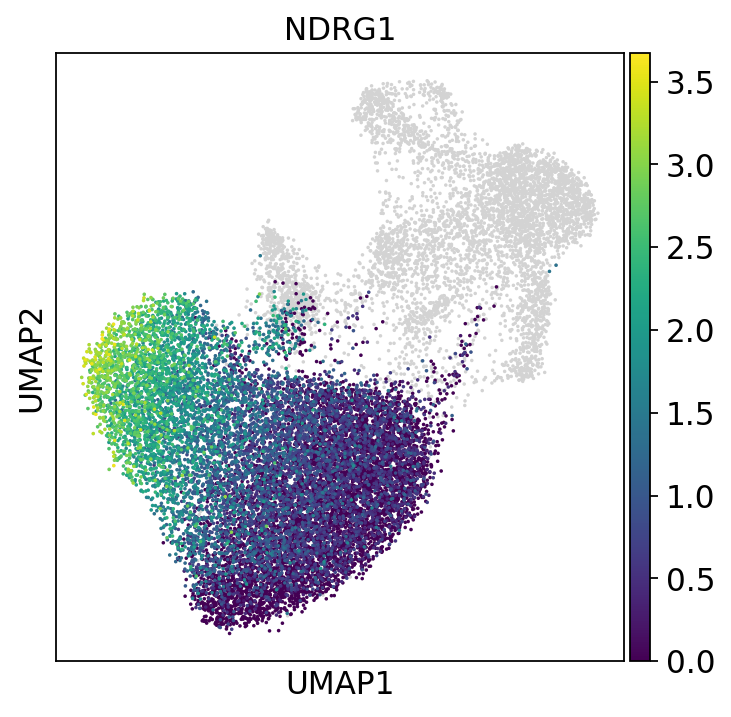

In [48]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
dot_size=10
# Plot all cells as background
ax=sc.pl.umap(adata, show=False,s=dot_size, ax=ax)

# Plot ontop expression of a single cell group by subsetting adata
sc.pl.umap(adata[adata.obs.cell_type=='tumor',:],color='NDRG1', ax=ax, s=dot_size)

## Plot the leiden clusters of two FOVs

CPU times: user 17.1 s, sys: 9.89 s, total: 27 s
Wall time: 27.1 s


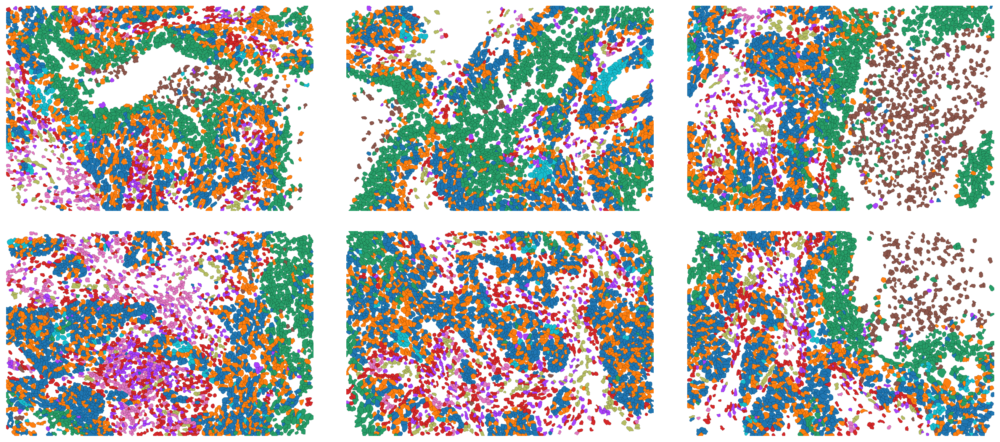

In [49]:
%%time
sq.pl.spatial_segment(
    adata,
    color='leiden',
    library_key="fov",
    library_id = selected_fovs,
    seg_cell_id="cell_ID", 
    seg_outline = True,
    # palette='tab20',
    img=False,
    colorbar=False,
    hspace=0, wspace=0,
    ncols=3,
    legend_loc=None,
    outline=False,
    axis_label = None,
    figsize=(7,4.5),
    # library_first=True,
    frameon=False,
    title='',
)

CPU times: user 17 s, sys: 9.6 s, total: 26.6 s
Wall time: 26.7 s


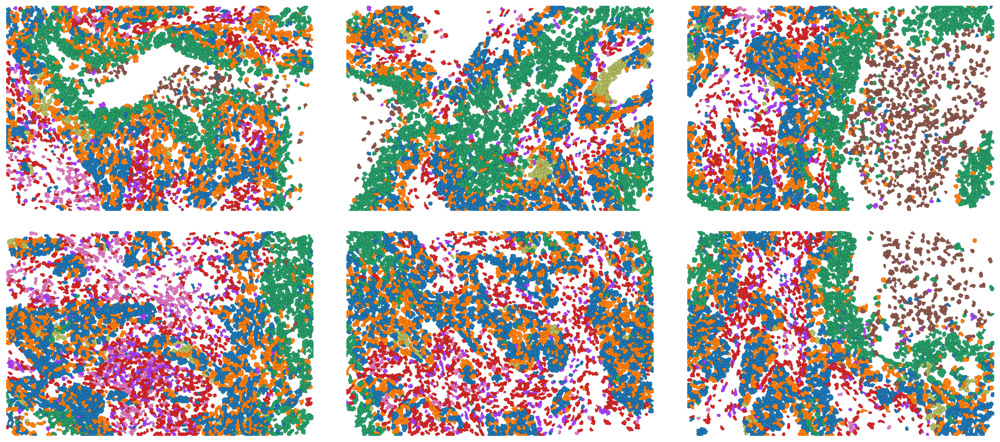

In [50]:
%%time
sq.pl.spatial_segment(
    adata,
    color='louvain',
    library_key="fov",
    library_id = selected_fovs,
    seg_cell_id="cell_ID", 
    seg_outline = True,
    # palette='tab20',
    img=False,
    colorbar=False,
    hspace=0.0001, wspace=0.0001,
    ncols=3,
    legend_loc=None,
    outline=False,
    axis_label = None,
    figsize=(7,4.5),
    # library_first=True,
    frameon=False,
    title='',
)

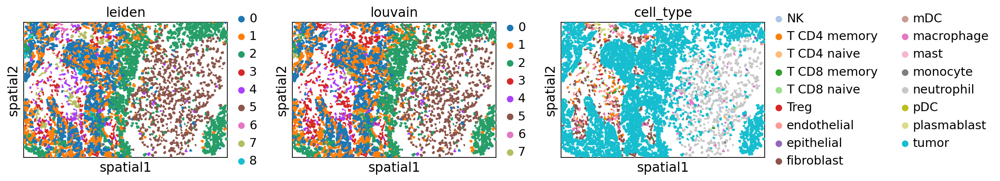

In [51]:
fig, ax = plt.subplots(1, 3, figsize=(15, 7))

for _ax in ax:
    _ax.set_facecolor('white')

selected_fov = 19
    # [17, 18, 19, 13, 14, 15]
    
sq.pl.spatial_segment(
    adata,
    shape="hex",
    color="leiden",
    library_key="fov",
    library_id=f"{selected_fov}",
    seg_cell_id="cell_ID",
    img=False,
    size=60,
    ax=ax[0],
)

sq.pl.spatial_segment(
    adata,
    shape="hex",
    color="louvain",
    library_key="fov",
    library_id=f"{selected_fov}",
    seg_cell_id="cell_ID",
    img=False,
    size=60,
    ax=ax[1],
)

sq.pl.spatial_segment(
    adata,
    shape="hex",
    color="cell_type",
    library_key="fov",
    library_id=f"{selected_fov}",
    seg_cell_id="cell_ID",
    img=False,
    size=60,
    ax=ax[2],
)

plt.tight_layout()

## Plot the spatial map of the PanCK staining intensity

CPU times: user 17.1 s, sys: 10.2 s, total: 27.3 s
Wall time: 27.4 s


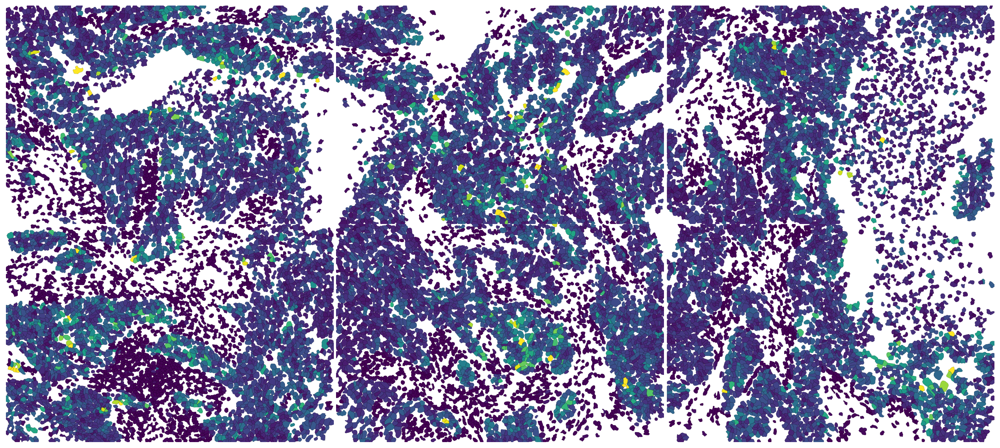

In [52]:
%%time
sq.pl.spatial_segment(
    adata,
    color='Max.PanCK',
    library_key="fov",
    library_id = selected_fovs,
    seg_cell_id="cell_ID", 
    seg_outline = True,
    img=False,
    colorbar=False,
    hspace=0, wspace=0,
    ncols=3,
    legend_loc=None,
    outline=False,
    axis_label = None,
    figsize=(7,4.5),
    frameon=False,
    title='',
)

## Spatial Connectivity Analysis

In [53]:
adata

AnnData object with n_obs × n_vars = 19873 × 960
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'tissue', 'cell_type', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_counts', 'louvain', 'leiden'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'spatial', 'cell_type_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'louvain', 'leiden', 'leiden_colors', 'louvain_colors'
    obsm:

CPU times: user 4.44 s, sys: 1.89 s, total: 6.33 s
Wall time: 6.32 s


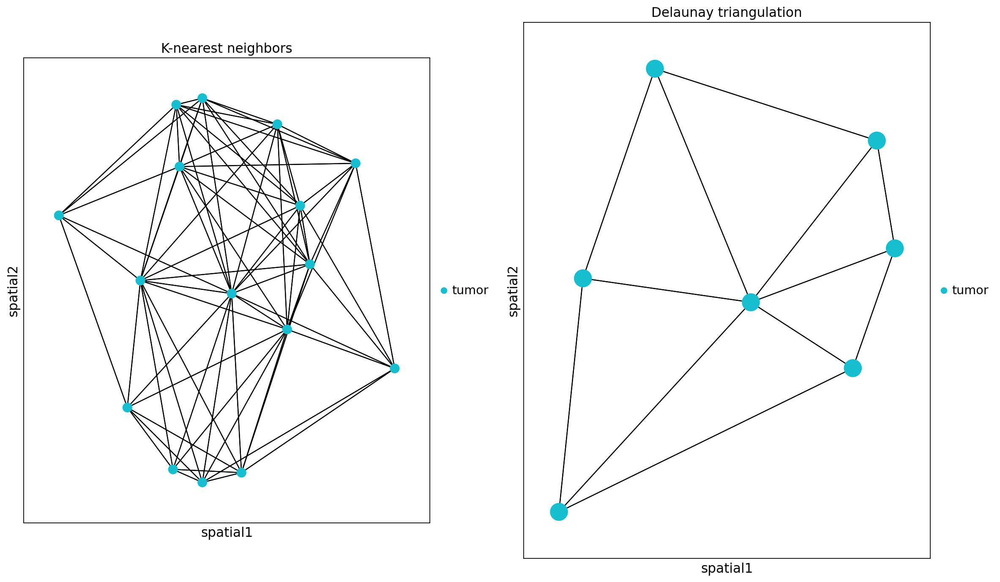

In [54]:
%%time
fig, ax = plt.subplots(1, 2, figsize=(15, 15))
sq.gr.spatial_neighbors(
    adata,
    n_neighs=15,
    coord_type="generic",
)
_, idx = adata.obsp["spatial_connectivities"][1111, :].nonzero()
idx = np.append(idx, 1111)
sq.pl.spatial_scatter(
    adata[idx, :],
    library_id="16",
    color="cell_type",
    connectivity_key="spatial_connectivities",
    size=3,
    edges_width=1,
    edges_color="black",
    img=False,
    title="K-nearest neighbors",
    ax=ax[0],
)

sq.gr.spatial_neighbors(
    adata,
    n_neighs=15,
    coord_type="generic",
    delaunay=True,
)
_, idx = adata.obsp["spatial_connectivities"][1111, :].nonzero()
idx = np.append(idx, 1111)
sq.pl.spatial_scatter(
    adata[idx, :],
    library_id="16",
    color="cell_type",
    connectivity_key="spatial_connectivities",
    size=3,
    edges_width=1,
    edges_color="black",
    img=False,
    title="Delaunay triangulation",
    ax=ax[1],
)

plt.tight_layout()

In [55]:
%%time
sq.gr.centrality_scores(adata, cluster_key="cell_type")

CPU times: user 4.86 s, sys: 117 ms, total: 4.98 s
Wall time: 4.99 s


- closeness centrality - measure of how close the group is to other nodes.
- clustering coefficient - measure of the degree to which nodes cluster together.
- degree centrality - fraction of non-group members connected to group members.

CPU times: user 148 ms, sys: 4.86 ms, total: 152 ms
Wall time: 226 ms


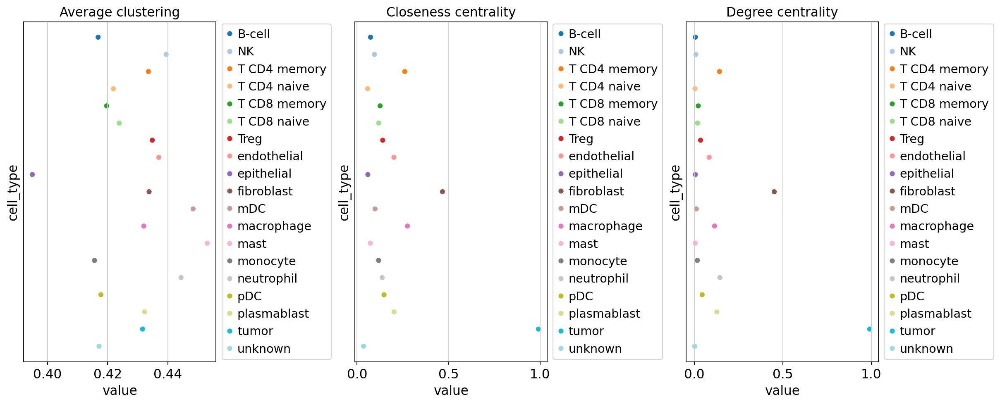

In [56]:
%%time
sq.pl.centrality_scores(adata, cluster_key="cell_type", figsize=(15, 6))

## Spatial Co-Occurance

In [57]:
adataset = adata[adata.obs.fov.isin(["17", "18"])].copy()

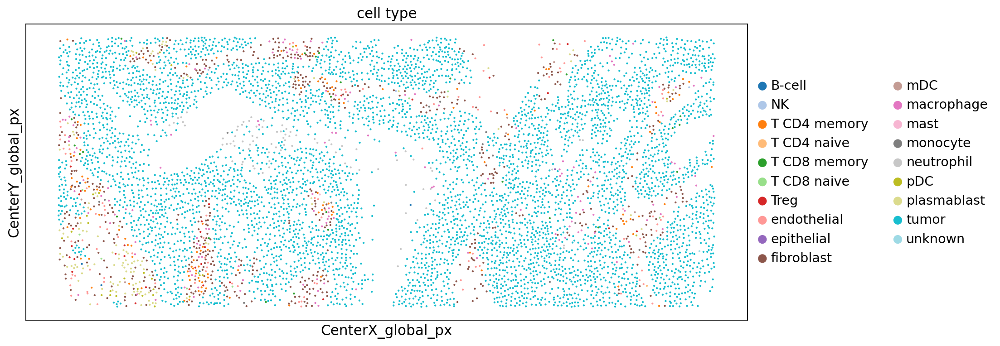

In [58]:
fig, ax = plt.subplots(1, 1, figsize=(14, 5))

# Create the scatter plot without grid lines
ax = sc.pl.scatter(
    adataset,
    x='CenterX_global_px',
    y='CenterY_global_px',
    color='cell_type',
    show=False, 
    size=15,
    frameon=False, 
    ax=ax
    # legend_loc='none'
)

# Turn off x and y axes
ax.set_xticks([])
ax.set_yticks([])

plt.tight_layout()

In [59]:
sq.gr.co_occurrence(
    adataset,
    cluster_key="cell_type",
)

  0%|          | 0/1 [00:00<?, ?/s]

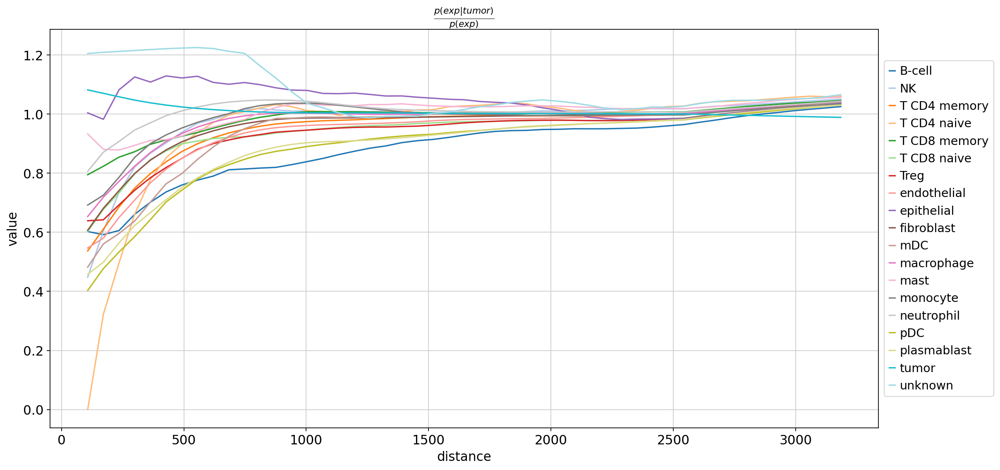

In [60]:
sq.pl.co_occurrence(
    adataset,
    cluster_key="cell_type",
    clusters='tumor', figsize=(15, 7), 
)

## Neighborhood Enrichment Analysis

In [61]:
%%time
sq.gr.nhood_enrichment(adata, cluster_key="cell_type")

  0%|          | 0/1000 [00:00<?, ?/s]

CPU times: user 3.47 s, sys: 944 ms, total: 4.41 s
Wall time: 4.59 s


In [62]:
%%time
sq.gr.nhood_enrichment(adataset, cluster_key="cell_type")

  0%|          | 0/1000 [00:00<?, ?/s]

CPU times: user 455 ms, sys: 195 ms, total: 650 ms
Wall time: 786 ms


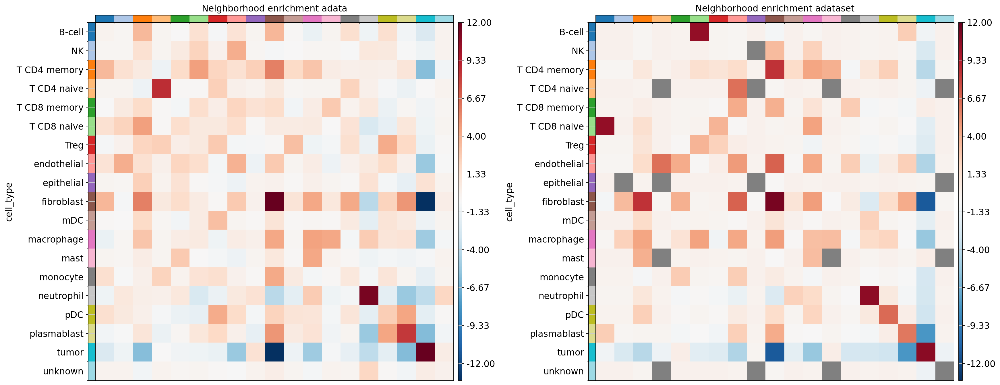

In [63]:
fig, ax = plt.subplots(1, 2, figsize=(22, 22))
sq.pl.nhood_enrichment(
    adata,
    cluster_key="cell_type",
    figsize=(3, 3), vmin=12, vmax=-12, vcenter=0,
    ax=ax[0],
    title="Neighborhood enrichment adata", cmap='RdBu_r'
)
sq.pl.nhood_enrichment(
    adataset,
    cluster_key="cell_type",
    figsize=(3, 3), vmin=12, vmax=-12, vcenter=0,
    ax=ax[1],
    title="Neighborhood enrichment adataset", cmap='RdBu_r'
)

plt.tight_layout()

## Spatial statistics

### Ripley's L

https://en.wikipedia.org/wiki/Spatial_descriptive_statistics

CPU times: user 6.39 s, sys: 1.73 s, total: 8.12 s
Wall time: 8.13 s


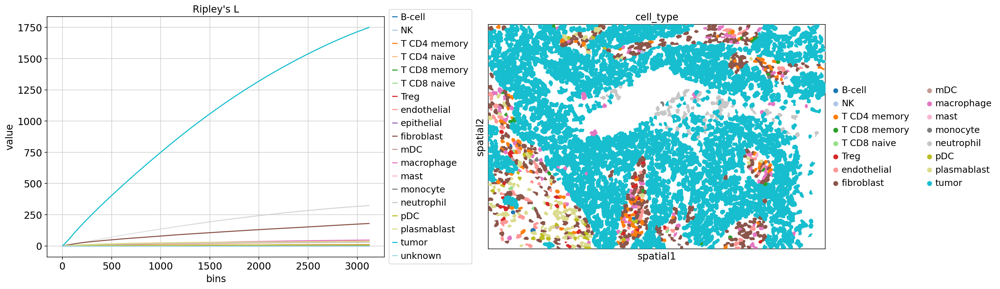

In [64]:
%%time
mode = "L"
fig, ax = plt.subplots(1, 2, figsize=(20, 6))

sq.gr.ripley(adataset, cluster_key="cell_type", mode=mode)
sq.pl.ripley(
    adataset,
    cluster_key="cell_type",
    mode=mode,
    ax=ax[0],
)

sq.pl.spatial_segment(
    adataset,
    shape="hex",
    color="cell_type",
    library_id=["17"],
    library_key="fov",
    seg_cell_id="cell_ID",
    img=False,
    size=60,
    ax=ax[1],
)

plt.tight_layout()

### Spatial Correlation Analysis of genes

In [65]:
%%time
sq.gr.spatial_neighbors(adataset, coord_type="generic", delaunay=True)
sq.gr.spatial_autocorr(
    adataset,
    mode="moran",
    n_perms=100,
    n_jobs=1,
)
adataset.uns["moranI"].head(10)

  0%|          | 0/100 [00:00<?, ?/s]

CPU times: user 39.8 s, sys: 462 ms, total: 40.3 s
Wall time: 15.8 s


,I,pval_norm,var_norm,pval_z_sim,pval_sim,var_sim,pval_norm_fdr_bh,pval_z_sim_fdr_bh,pval_sim_fdr_bh
NDRG1,0.373584,0.0,0.000052,0.0,0.009901,0.000077,0.0,0.0,0.01292
HSP90AB1,0.288622,0.0,0.000052,0.0,0.009901,0.000054,0.0,0.0,0.01292
CXCL10,0.283904,0.0,0.000052,0.0,0.009901,0.000064,0.0,0.0,0.01292
IGHG1,0.265413,0.0,0.000052,0.0,0.009901,0.000056,0.0,0.0,0.01292
COL3A1,0.264011,0.0,0.000052,0.0,0.009901,0.000055,0.0,0.0,0.01292
MIF,0.260233,0.0,0.000052,0.0,0.009901,0.000055,0.0,0.0,0.01292
VEGFA,0.257978,0.0,0.000052,0.0,0.009901,0.000054,0.0,0.0,0.01292
IGHG2,0.253867,0.0,0.000052,0.0,0.009901,0.000056,0.0,0.0,0.01292
IGFBP5,0.246470,0.0,0.000052,0.0,0.009901,0.000068,0.0,0.0,0.01292
SLC2A1,0.237811,0.0,0.000052,0.0,0.009901,0.000049,0.0,0.0,0.01292


In [66]:
%%time
sq.gr.spatial_neighbors(adataset, coord_type="generic", delaunay=True)
sq.gr.spatial_autocorr(
    adataset,
    mode="moran",
    n_perms=100,
    n_jobs=1,
)
adataset.uns["moranI"].head(10)

  0%|          | 0/100 [00:00<?, ?/s]

CPU times: user 38.7 s, sys: 389 ms, total: 39.1 s
Wall time: 13.4 s


,I,pval_norm,var_norm,pval_z_sim,pval_sim,var_sim,pval_norm_fdr_bh,pval_z_sim_fdr_bh,pval_sim_fdr_bh
NDRG1,0.373584,0.0,0.000052,0.0,0.009901,0.000065,0.0,0.0,0.012651
HSP90AB1,0.288622,0.0,0.000052,0.0,0.009901,0.000045,0.0,0.0,0.012651
CXCL10,0.283904,0.0,0.000052,0.0,0.009901,0.000059,0.0,0.0,0.012651
IGHG1,0.265413,0.0,0.000052,0.0,0.009901,0.000061,0.0,0.0,0.012651
COL3A1,0.264011,0.0,0.000052,0.0,0.009901,0.000061,0.0,0.0,0.012651
MIF,0.260233,0.0,0.000052,0.0,0.009901,0.000073,0.0,0.0,0.012651
VEGFA,0.257978,0.0,0.000052,0.0,0.009901,0.000061,0.0,0.0,0.012651
IGHG2,0.253867,0.0,0.000052,0.0,0.009901,0.000048,0.0,0.0,0.012651
IGFBP5,0.246470,0.0,0.000052,0.0,0.009901,0.000045,0.0,0.0,0.012651
SLC2A1,0.237811,0.0,0.000052,0.0,0.009901,0.000045,0.0,0.0,0.012651


In [67]:
adataset.uns["moranI"].index[:10]

Index(['NDRG1', 'HSP90AB1', 'CXCL10', 'IGHG1', 'COL3A1', 'MIF', 'VEGFA',
       'IGHG2', 'IGFBP5', 'SLC2A1'],
      dtype='object')

CPU times: user 6.4 s, sys: 4.02 s, total: 10.4 s
Wall time: 10.4 s


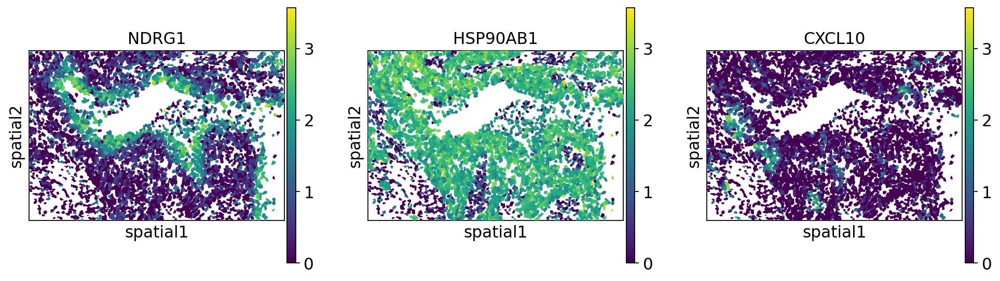

In [68]:
%%time
sq.pl.spatial_segment(
    adataset,
    shape="hex",
     color=["NDRG1", "HSP90AB1", "CXCL10"],
    library_id=["17"],
    library_key="fov",
    seg_cell_id="cell_ID", 
    palette=None,
    legend_loc=None,
    img=False,
    ncols=4,
    size=40,)

plt.tight_layout()

# Niche analysis

In [69]:

def calculate_neighborhood_cell_composition_anndata(adata, n_neighbors=200, spatial_key='spatial_fov', cell_type_col='cell_type'):
    """
    This function calculates the composition of cell types in the neighborhoods 
    of each cell in a given AnnData object and returns the modified AnnData.
    
    Parameters:
    - adata: AnnData object containing cell data, including x and y coordinates and cell types.
    - n_neighbors: Number of nearest neighbors to consider for each cell. Default is 200.
    
    Returns:
    - adata: AnnData object with added columns representing the composition of cell types 
             in the neighborhoods of each cell.
    """

    # Extracting coordinates and cell types from the AnnData object
    coords = adata.obsm[spatial_key]
    cell_types = adata.obs[cell_type_col].values
    
    # Obtaining unique cell types and sorting them
    unique_cell_types = sorted(adata.obs[cell_type_col].unique())

    # Initializing a NearestNeighbors object and fitting it to the data
    neigh = NearestNeighbors(n_neighbors=n_neighbors)
    neigh.fit(coords)

    # Finding the indices of nearest neighbors for each point
    _, neighbors_indices = neigh.kneighbors(coords)

    # Mapping cell types to indices for faster processing
    cell_type_to_index = {cell_type: i for i, cell_type in enumerate(unique_cell_types)}
    cell_type_indices = np.vectorize(cell_type_to_index.get)(cell_types)

    # Initializing an array to hold the counts of cell types in neighborhoods
    cell_composition_counts = np.zeros((len(adata), len(unique_cell_types)))

    # Printing progress information
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Calculating Neighborhood Cell Composition")

    # Counting the occurrences of each cell type in the neighborhoods
    for i, neighbors in enumerate(neighbors_indices):
        # Updating progress every 30000 iterations
        if i % 3000 == 0:
            print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Processing cell ID: {i}")
        neighbor_types = cell_type_indices[neighbors]
        for neighbor_type in neighbor_types:
            cell_composition_counts[i, neighbor_type] += 1

    # Creating a DataFrame from the counts
    cell_composition_df = pd.DataFrame(
        cell_composition_counts, 
        columns=[f'n_{ct}' for ct in unique_cell_types], 
        index=adata.obs.index
    )

    # Adding the new DataFrame to the AnnData object's .obs attribute
    for col in cell_composition_df.columns:
        adata.obs[col] = cell_composition_df[col].values

    # Printing completion message
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Completed Neighborhood Cell Composition")

    return adata


In [70]:
adata

AnnData object with n_obs × n_vars = 19873 × 960
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'tissue', 'cell_type', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_counts', 'louvain', 'leiden'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'spatial', 'cell_type_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'louvain', 'leiden', 'leiden_colors', 'louvain_colors', 'spatial

In [71]:
%%time
adata = calculate_neighborhood_cell_composition_anndata(adata, n_neighbors=100, spatial_key='spatial_fov', cell_type_col='cell_type')

[2024-10-07 15:43:31] Calculating Neighborhood Cell Composition
[2024-10-07 15:43:31] Processing cell ID: 0
[2024-10-07 15:43:31] Processing cell ID: 3000
[2024-10-07 15:43:31] Processing cell ID: 6000
[2024-10-07 15:43:31] Processing cell ID: 9000
[2024-10-07 15:43:31] Processing cell ID: 12000
[2024-10-07 15:43:31] Processing cell ID: 15000
[2024-10-07 15:43:31] Processing cell ID: 18000
[2024-10-07 15:43:31] Completed Neighborhood Cell Composition
CPU times: user 835 ms, sys: 20.7 ms, total: 855 ms
Wall time: 857 ms


In [72]:
adata

AnnData object with n_obs × n_vars = 19873 × 960
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'tissue', 'cell_type', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_counts', 'louvain', 'leiden', 'n_B-cell', 'n_NK', 'n_T CD4 memory', 'n_T CD4 naive', 'n_T CD8 memory', 'n_T CD8 naive', 'n_Treg', 'n_endothelial', 'n_epithelial', 'n_fibroblast', 'n_mDC', 'n_macrophage', 'n_mast', 'n_monocyte', 'n_neutrophil', 'n_pDC', 'n_plasmablast', 'n_tumor', 'n_unknown'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_coun

In [73]:
niche_columns = ['n_'+ctype for ctype in adata.obs.cell_type.unique()]

adata.obs[niche_columns]

,n_tumor,n_macrophage,n_plasmablast,n_T CD4 memory,n_fibroblast,n_pDC,n_Treg,n_T CD8 naive,n_monocyte,n_neutrophil,n_mast,n_NK,n_endothelial,n_T CD8 memory,n_B-cell,n_mDC,n_T CD4 naive,n_epithelial,n_unknown
10_13,34.0,4.0,22.0,5.0,26.0,6.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12_13,62.0,4.0,1.0,10.0,18.0,2.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21_13,58.0,4.0,0.0,2.0,28.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0
26_13,74.0,2.0,0.0,4.0,14.0,0.0,2.0,1.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
27_13,71.0,2.0,0.0,4.0,15.0,0.0,2.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4425_19,96.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4426_19,85.0,0.0,0.0,0.0,15.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4427_19,62.0,2.0,0.0,6.0,23.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,4.0,2.0,0.0,0.0,0.0,0.0,0.0
4431_19,99.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# Plot cell type compositions

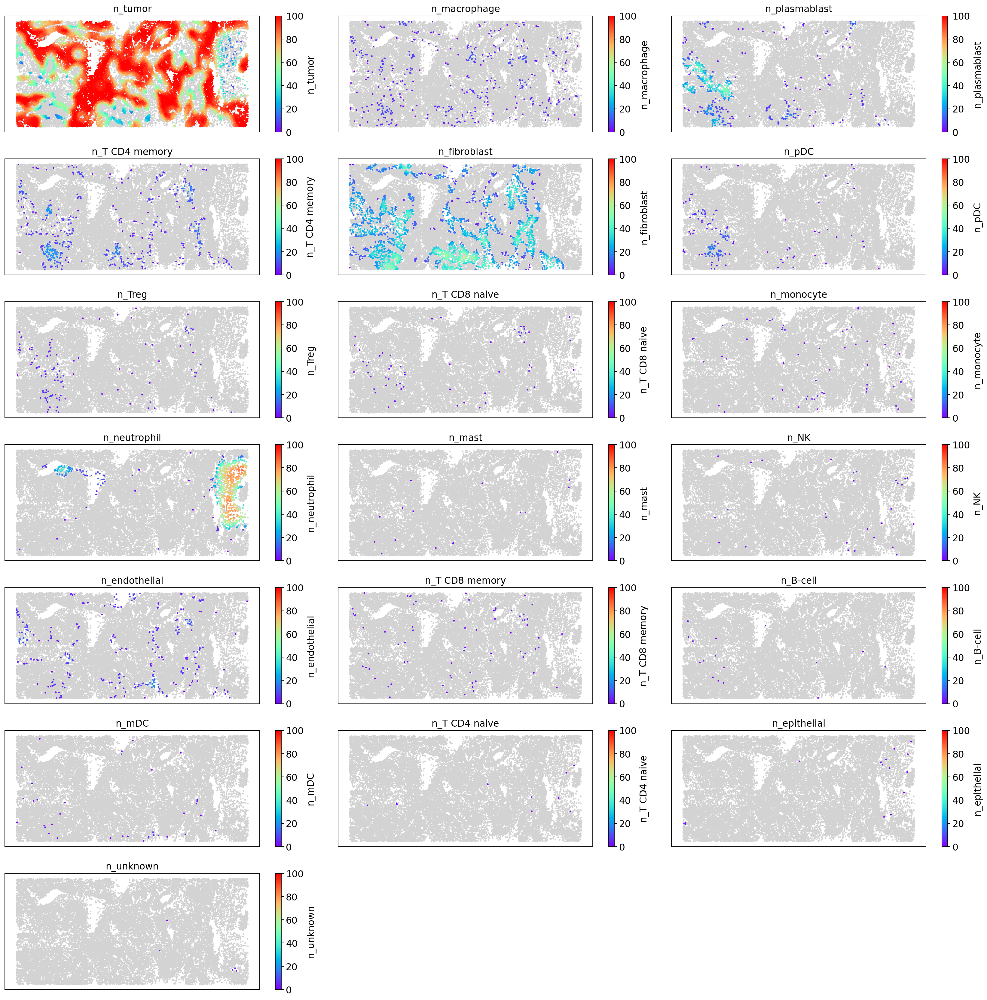

In [74]:
import matplotlib.pyplot as plt
import numpy as np
import math

unique_ctypes = list(adata.obs.cell_type.unique())

# Set the number of columns
ncols = 3
# Calculate the number of rows based on the number of unique cell types and columns
nrows = math.ceil(len(unique_ctypes) / ncols)

fig, axes = plt.subplots(nrows, ncols, figsize=(7 * ncols, 3 * nrows))

# Coordinates of all cells
x_all = adata.obs['CenterX_global_px']
y_all = adata.obs['CenterY_global_px']

# Flatten the axes array for easy iteration (in case of multiple rows and columns)
axes = axes.flatten()

# Plot each niche in its own subplot
for i, ctype in enumerate(unique_ctypes):
    ax = axes[i]
    
    # Plot all cells in gray
    ax.scatter(
        x_all,
        y_all,
        c='lightgray',
        s=2,
        label='Other cells'
    )
    
    # Get the data for the current cell type
    ctype_data = adata.obs[adata.obs['cell_type'] == ctype]
    x = ctype_data['CenterX_global_px']
    y = ctype_data['CenterY_global_px']
    values = ctype_data[f'n_{ctype}']  # Values to use for the colormap
    
    # Plot the current cell type with a colormap
    scatter = ax.scatter(
        x,
        y,
        c=values,  # Use the values from the column for color mapping
        s=2,
        vmin=0,
        vmax=100,
        cmap='rainbow',  # Specify the colormap
        label=f'n_{ctype}'
    )
    
    # Add a colorbar to show the range of the values
    plt.colorbar(scatter, ax=ax, label=f'n_{ctype}')
    
    # Turn off x and y axes ticks
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(f'n_{ctype}')  # Add the niche label as the subplot title

# Turn off unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


## Perform K-means clustering on the niche vectors

In [75]:
%%time
n_clusters = 5
random_state = 1111

kmeans = KMeans(n_clusters=n_clusters, random_state=random_state)
adata.obs['niche_kmeans'] = kmeans.fit_predict(adata.obs[niche_columns])

# Prepend 'niche_' to the K-means cluster labels
adata.obs['niche_kmeans'] = adata.obs['niche_kmeans'].astype(str).astype('category')
adata.obs['niche_kmeans'] = adata.obs['niche_kmeans'].cat.rename_categories(lambda x: f'niche_{x}')

CPU times: user 1.02 s, sys: 64.8 ms, total: 1.09 s
Wall time: 350 ms


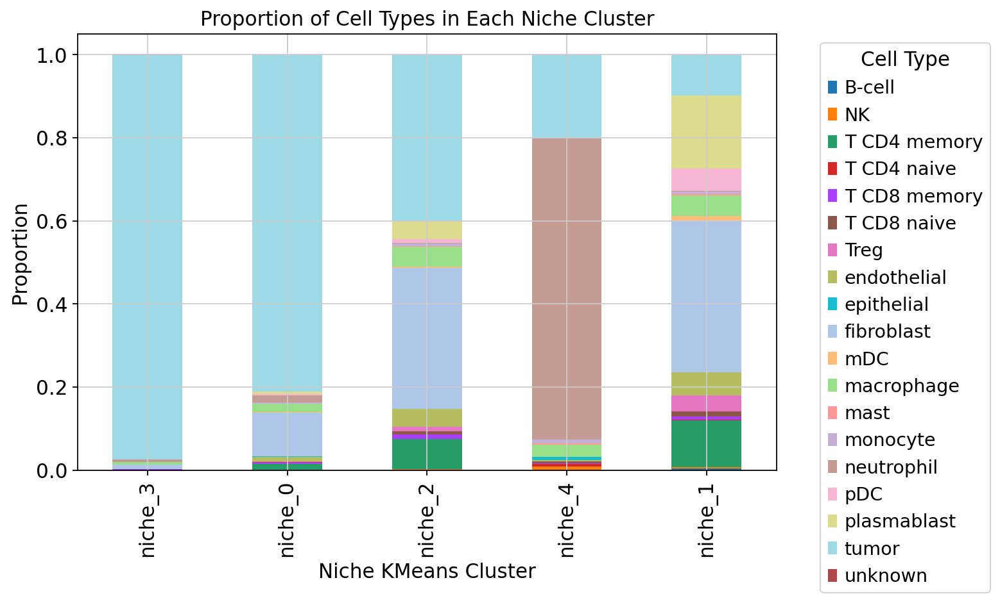

In [76]:
def plot_cell_type_proportions(adata, sort_by_cell_type=None):
    # Group by 'niche_kmeans' and 'cell_type' to count occurrences
    count_df = adata.obs.groupby(['niche_kmeans', 'cell_type']).size().reset_index(name='counts')
    
    # Calculate proportions for each 'niche_kmeans'
    total_counts = count_df.groupby('niche_kmeans')['counts'].transform('sum')
    count_df['proportion'] = count_df['counts'] / total_counts
    
    # Create a pivot table for plotting
    pivot_df = count_df.pivot(index='niche_kmeans', columns='cell_type', values='proportion').fillna(0)
    
    # Sort pivot_df based on the specified cell type if provided
    if sort_by_cell_type and sort_by_cell_type in pivot_df.columns:
        pivot_df = pivot_df.sort_values(by=sort_by_cell_type, ascending=False)
    
    # Plotting the proportion bar plot
    pivot_df.plot(kind='bar', stacked=True, figsize=(10, 6))
    plt.ylabel('Proportion')
    plt.xlabel('Niche KMeans Cluster')
    plt.title('Proportion of Cell Types in Each Niche Cluster')
    plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

# Example usage: Sort by a specific cell type
plot_cell_type_proportions(adata, sort_by_cell_type='tumor')


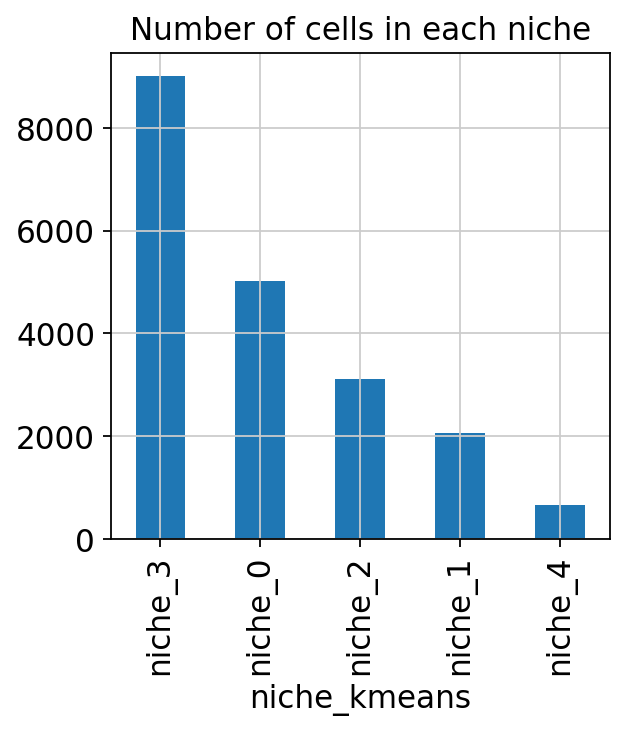

In [77]:
_ = adata.obs.niche_kmeans.value_counts().plot(kind='bar', title='Number of cells in each niche')

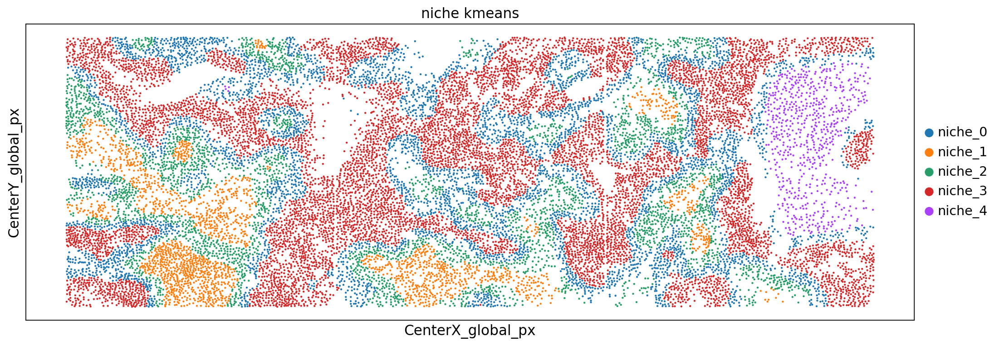

In [78]:
fig, ax = plt.subplots(1, 1, figsize=(14, 5))

# Create the scatter plot without grid lines
ax = sc.pl.scatter(
    adata,
    x='CenterX_global_px',
    y='CenterY_global_px',
    color='niche_kmeans',
    show=False, 
    size=15,
    frameon=False, 
    ax=ax,
)

# Turn off x and y axes
ax.set_xticks([])
ax.set_yticks([])

plt.tight_layout()

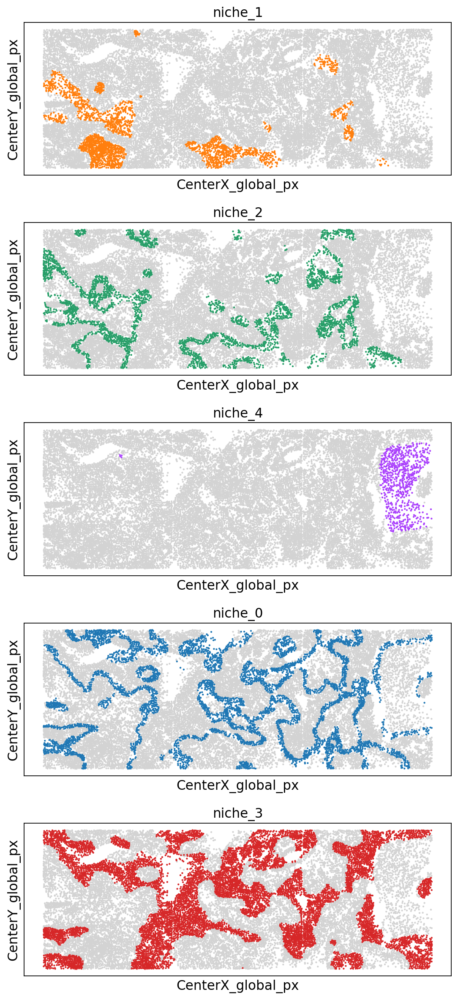

In [79]:
niche_labels = ['niche_1', 'niche_2', 'niche_4', 'niche_0', 'niche_3']

fig, axes = plt.subplots(len(niche_labels), 1, figsize=(7, 3 * len(niche_labels)))

# If there's only one niche, axes will not be an array; we convert it to a list for uniform handling
if len(niche_labels) == 1:
    axes = [axes]

# Plot each niche in its own subplot
for i, niche in enumerate(niche_labels):
    ax = axes[i]
    sc.pl.scatter(
        adata,
        x='CenterX_global_px',
        y='CenterY_global_px',
        color='niche_kmeans',
        groups=[niche],
        show=False,
        size=15,
        frameon=False,
        ax=ax,
        legend_loc='none'  # Hide legend to avoid repetition in each subplot
    )
    # Turn off x and y axes ticks
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(niche)  # Add the niche label as the subplot title

plt.tight_layout()
plt.show()

## Differentially expressed genes among the niches

In [80]:
%%time
groupby='niche_kmeans'
method='wilcoxon'
n_genes = 5

# Perform differential expression analysis
sc.tl.dendrogram(adata, groupby=groupby)
sc.tl.rank_genes_groups(adata, 
                        groupby=groupby, 
                        method=method, 
                        n_genes=adata.n_vars, 
                        tie_correct=True                        
                       )

CPU times: user 8.97 s, sys: 2.18 s, total: 11.2 s
Wall time: 11.1 s


### Heatmap of DE genes

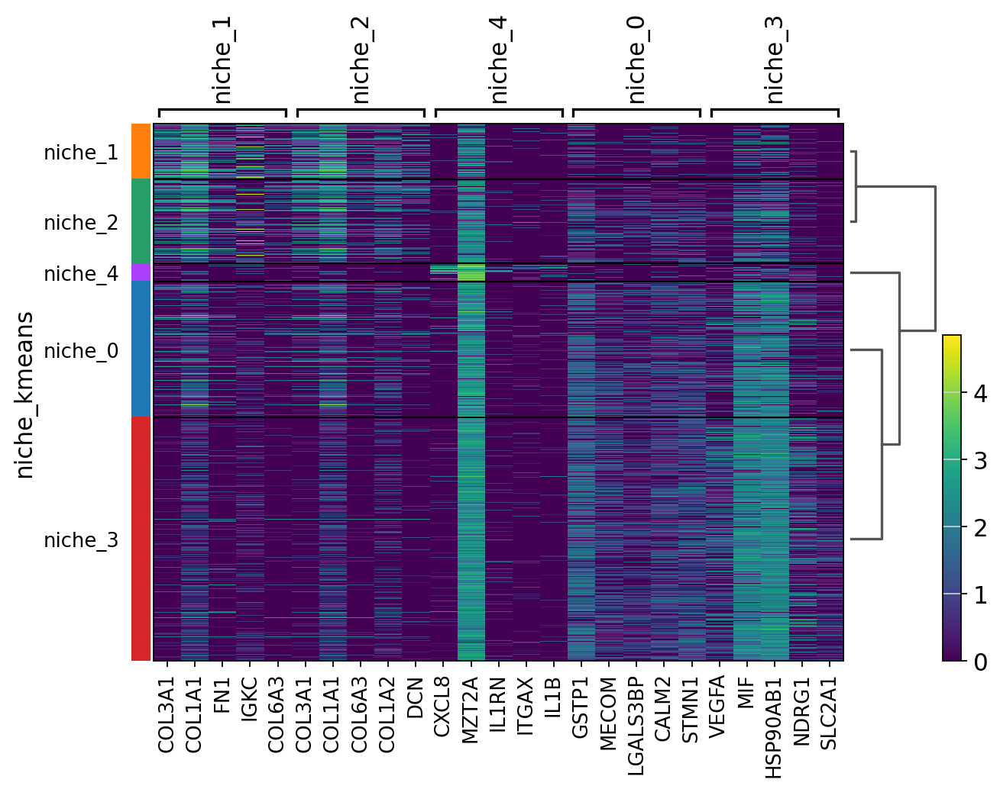

In [81]:
sc.pl.rank_genes_groups_heatmap(
    adata,
    groupby=groupby,
    n_genes=n_genes,
    use_raw=False,
    show=True,
    dendrogram=True
)

### Dot plot of DE genes

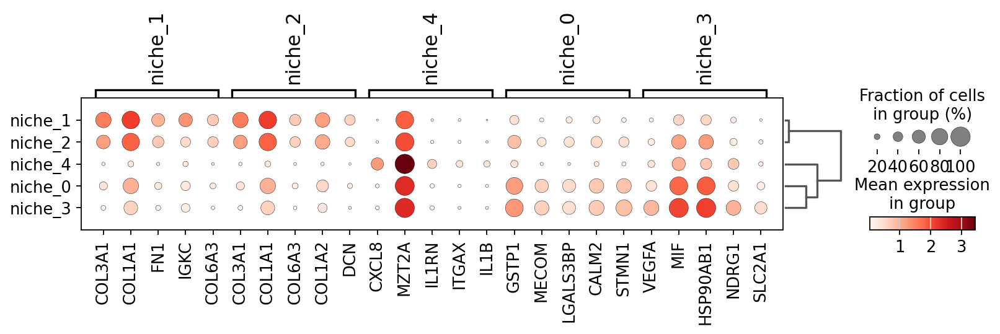

In [82]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby=groupby,
    n_genes=n_genes,
    use_raw=False,
    show=True
)

In [83]:
adata

AnnData object with n_obs × n_vars = 19873 × 960
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'tissue', 'cell_type', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_counts', 'louvain', 'leiden', 'n_B-cell', 'n_NK', 'n_T CD4 memory', 'n_T CD4 naive', 'n_T CD8 memory', 'n_T CD8 naive', 'n_Treg', 'n_endothelial', 'n_epithelial', 'n_fibroblast', 'n_mDC', 'n_macrophage', 'n_mast', 'n_monocyte', 'n_neutrophil', 'n_pDC', 'n_plasmablast', 'n_tumor', 'n_unknown', 'niche_kmeans'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct

### DE analysis between tumor cells in different niches

In [84]:
adata_tumor = adata[adata.obs.cell_type=='tumor']

In [85]:
adata_tumor = adata_tumor[adata_tumor.obs['niche_kmeans'].isin(['niche_1', 'niche_3'])]
adata_tumor

View of AnnData object with n_obs × n_vars = 8978 × 960
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'tissue', 'cell_type', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_counts', 'louvain', 'leiden', 'n_B-cell', 'n_NK', 'n_T CD4 memory', 'n_T CD4 naive', 'n_T CD8 memory', 'n_T CD8 naive', 'n_Treg', 'n_endothelial', 'n_epithelial', 'n_fibroblast', 'n_mDC', 'n_macrophage', 'n_mast', 'n_monocyte', 'n_neutrophil', 'n_pDC', 'n_plasmablast', 'n_tumor', 'n_unknown', 'niche_kmeans'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts

In [86]:
%%time
groupby = 'niche_kmeans'
sc.tl.dendrogram(adata_tumor, groupby=groupby)
sc.tl.rank_genes_groups(adata_tumor, groupby=groupby)

CPU times: user 791 ms, sys: 1.19 s, total: 1.98 s
Wall time: 1.97 s


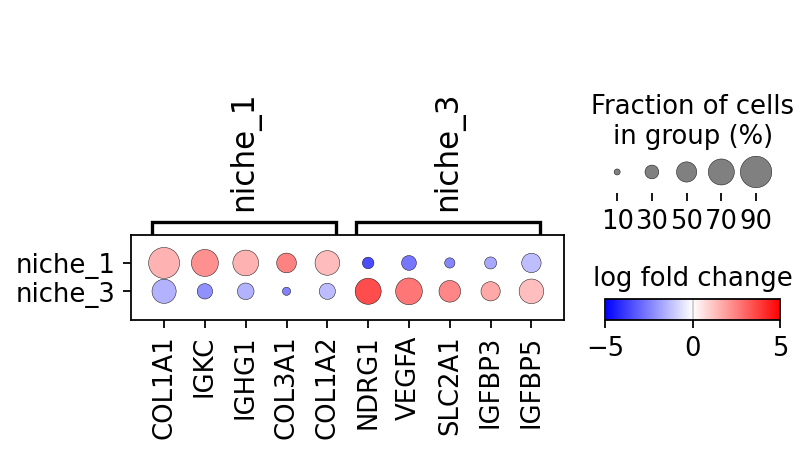

In [87]:
sc.pl.rank_genes_groups_dotplot(
    adata_tumor,
    groupby=groupby,
    values_to_plot='logfoldchanges',
    cmap='bwr',
    n_genes=n_genes,
    use_raw=False,
    vmin=-5, vmax=5,
    show=True
)

Top Enriched Terms for niche_1
Top Enriched Terms for niche_3


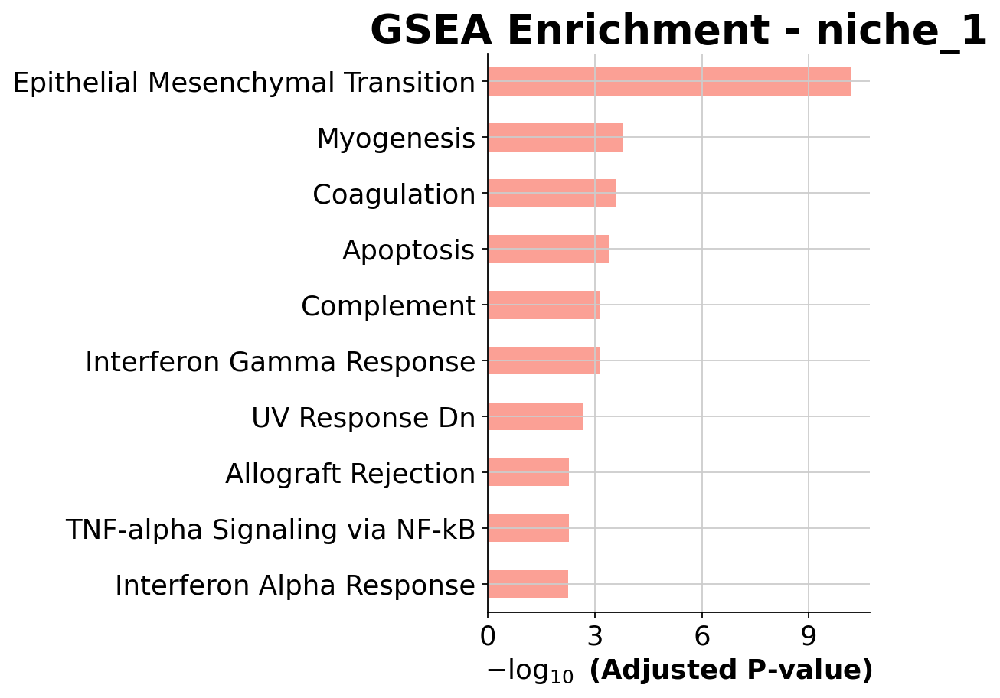

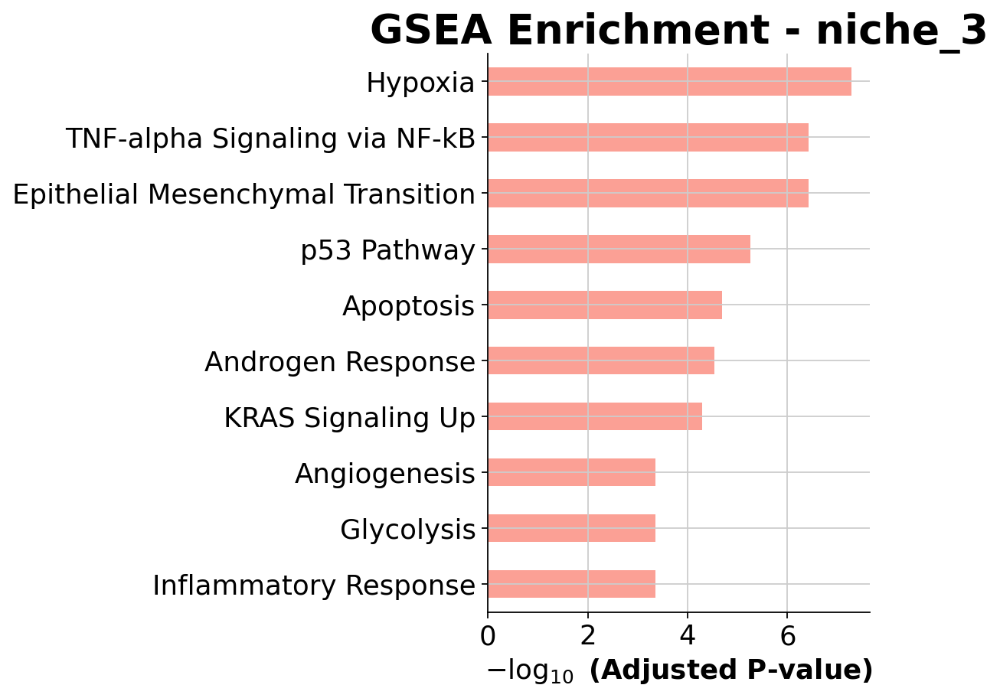

CPU times: user 759 ms, sys: 85 ms, total: 844 ms
Wall time: 2.96 s


In [88]:
%%time


# Step 1: Extract the top upregulated genes for each group
top_genes = {}
groupby = "cell_type"  # You can modify this to match your analysis
n_genes = 50           # Adjust as needed for your top n genes

# Get the ranked genes data
ranked_genes = adata_tumor.uns['rank_genes_groups']
groups = ranked_genes['names'].dtype.names

# Extract the top upregulated genes for each group
for group in groups:
    gene_names = ranked_genes['names'][group][:n_genes]
    logfold_changes = ranked_genes['logfoldchanges'][group][:n_genes]
    
    # Only keep upregulated genes
    upregulated_genes = [gene for gene, lfc in zip(gene_names, logfold_changes) if lfc > 0]
    top_genes[group] = upregulated_genes

# Step 2: Perform GSEA for each group
# Here, we use gene ontology (GO_Biological_Process_2021) as an example gene set library
gsea_results = {}
for group, genes in top_genes.items():
    if genes:
        enrichment_result = gp.enrichr(
            gene_list=genes,
            gene_sets=['GO_Biological_Process_2021', 'MSigDB_Hallmark_2020'],
            organism='Human',  # Change as needed: 'Mouse', etc.
            outdir=None,       # Disable file output
            verbose=False
        )
        gsea_results[group] = enrichment_result

        # Step 3: Plot the top enriched terms for each group
        if enrichment_result.res2d is not None and not enrichment_result.res2d.empty:
            print(f"Top Enriched Terms for {group}")
            barplot(enrichment_result.res2d, title=f"GSEA Enrichment - {group}")
        # print(enrichment_result.res2d)
plt.show()


## Ligand-Receptor Analysis

In [89]:
'VEGFB' in adata.var_names

True

In [90]:
lrs = mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='IL2')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='IL2RA')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='IL6')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='IL6R')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='JAG1')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='NOTCH1')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='NOTCH2')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='NOTCH3')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='VEGFA')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='VEGFB')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='FLT1')
lrs += mb.util.load_ligand_receptor_pairs_omnipath(adata, require_gene='KDR')
lrs

0.00B [00:00, ?B/s]

0.00B [00:00, ?B/s]

0.00B [00:00, ?B/s]

[('IL2', 'IL2RG'),
 ('IL2', 'IL2RB'),
 ('IL2', 'IL2RA'),
 ('IL2', 'CD53'),
 ('IL2', 'NGFR'),
 ('IL2', 'STAT6'),
 ('IL2', 'CXCL12'),
 ('IL2', 'IDO1'),
 ('IL2', 'CD28'),
 ('IL2', 'TGFB1'),
 ('IL2', 'MTOR'),
 ('IL2', 'HSP90AA1'),
 ('IL2', 'MAPK14'),
 ('IL2', 'TNFRSF9'),
 ('IL2', 'PTGES3'),
 ('IL2', 'KRAS'),
 ('IL2', 'IL4R'),
 ('IL2', 'IL27RA'),
 ('IL2', 'CCR5'),
 ('IL2', 'GZMB'),
 ('IL2', 'CD4'),
 ('IL2', 'PRF1'),
 ('IL2', 'BCL2L1'),
 ('IL2', 'TNFRSF4'),
 ('IL2', 'TNFRSF18'),
 ('IL2', 'STAT3'),
 ('IL2', 'ITGAM'),
 ('IL2', 'DPP4'),
 ('IL2', 'TNFRSF1A'),
 ('IL2', 'IL2RA'),
 ('ICAM1', 'IL2RA'),
 ('IL15', 'IL2RA'),
 ('IL1RN', 'IL2RA'),
 ('CD8B', 'IL2RA'),
 ('HLA-A', 'IL2RA'),
 ('CD8A', 'IL2RA'),
 ('IL6', 'IL6ST'),
 ('IL6', 'IL6R'),
 ('IL6', 'TLR2'),
 ('IL6', 'IL17A'),
 ('IL6', 'VEGFA'),
 ('IL6', 'IL1A'),
 ('IL6', 'NOTCH3'),
 ('IL6', 'MMP9'),
 ('IL6', 'PTGS2'),
 ('IL6', 'MET'),
 ('IL6', 'INSR'),
 ('IL6', 'KDR'),
 ('IL6', 'CCR7'),
 ('IL6', 'CXCL12'),
 ('IL6', 'BCL2'),
 ('IL6', 'TLR4'),
 ('IL6',

In [91]:
lr_pairs = []
for g1, g2 in lrs:
    if g2 in ['IL2', 'IL6', 'JAG1']:
        lr_pairs.append((g2, g1))
    else:
        lr_pairs.append((g1, g2))
lr_pairs

[('IL2', 'IL2RG'),
 ('IL2', 'IL2RB'),
 ('IL2', 'IL2RA'),
 ('IL2', 'CD53'),
 ('IL2', 'NGFR'),
 ('IL2', 'STAT6'),
 ('IL2', 'CXCL12'),
 ('IL2', 'IDO1'),
 ('IL2', 'CD28'),
 ('IL2', 'TGFB1'),
 ('IL2', 'MTOR'),
 ('IL2', 'HSP90AA1'),
 ('IL2', 'MAPK14'),
 ('IL2', 'TNFRSF9'),
 ('IL2', 'PTGES3'),
 ('IL2', 'KRAS'),
 ('IL2', 'IL4R'),
 ('IL2', 'IL27RA'),
 ('IL2', 'CCR5'),
 ('IL2', 'GZMB'),
 ('IL2', 'CD4'),
 ('IL2', 'PRF1'),
 ('IL2', 'BCL2L1'),
 ('IL2', 'TNFRSF4'),
 ('IL2', 'TNFRSF18'),
 ('IL2', 'STAT3'),
 ('IL2', 'ITGAM'),
 ('IL2', 'DPP4'),
 ('IL2', 'TNFRSF1A'),
 ('IL2', 'IL2RA'),
 ('ICAM1', 'IL2RA'),
 ('IL15', 'IL2RA'),
 ('IL1RN', 'IL2RA'),
 ('CD8B', 'IL2RA'),
 ('HLA-A', 'IL2RA'),
 ('CD8A', 'IL2RA'),
 ('IL6', 'IL6ST'),
 ('IL6', 'IL6R'),
 ('IL6', 'TLR2'),
 ('IL6', 'IL17A'),
 ('IL6', 'VEGFA'),
 ('IL6', 'IL1A'),
 ('IL6', 'NOTCH3'),
 ('IL6', 'MMP9'),
 ('IL6', 'PTGS2'),
 ('IL6', 'MET'),
 ('IL6', 'INSR'),
 ('IL6', 'KDR'),
 ('IL6', 'CCR7'),
 ('IL6', 'CXCL12'),
 ('IL6', 'BCL2'),
 ('IL6', 'TLR4'),
 ('IL6',

In [92]:
# For each pDC, find the neighboring Tregs
cell_to_neighbors = mb.calc.cell_neighbors(
    adata,
    groupby='cell_type',
    group1=['tumor'],
    group2=['fibroblast', 'neutrophil', 'T CD4 memory',],
    radius=50, 
    basis='spatial_fov',
) 

lr_pair_to_score = mb.calc.ligand_receptor_score(
    adata,
    cell_to_neighbors,
    lr_pairs=lr_pairs
)

In [93]:
res = mb.stat.ligand_receptor_score(
    adata,
    cell_to_neighbors,
    actual_scores=lr_pair_to_score
)

100%|██████████| 100/100 [01:28<00:00,  1.13it/s]


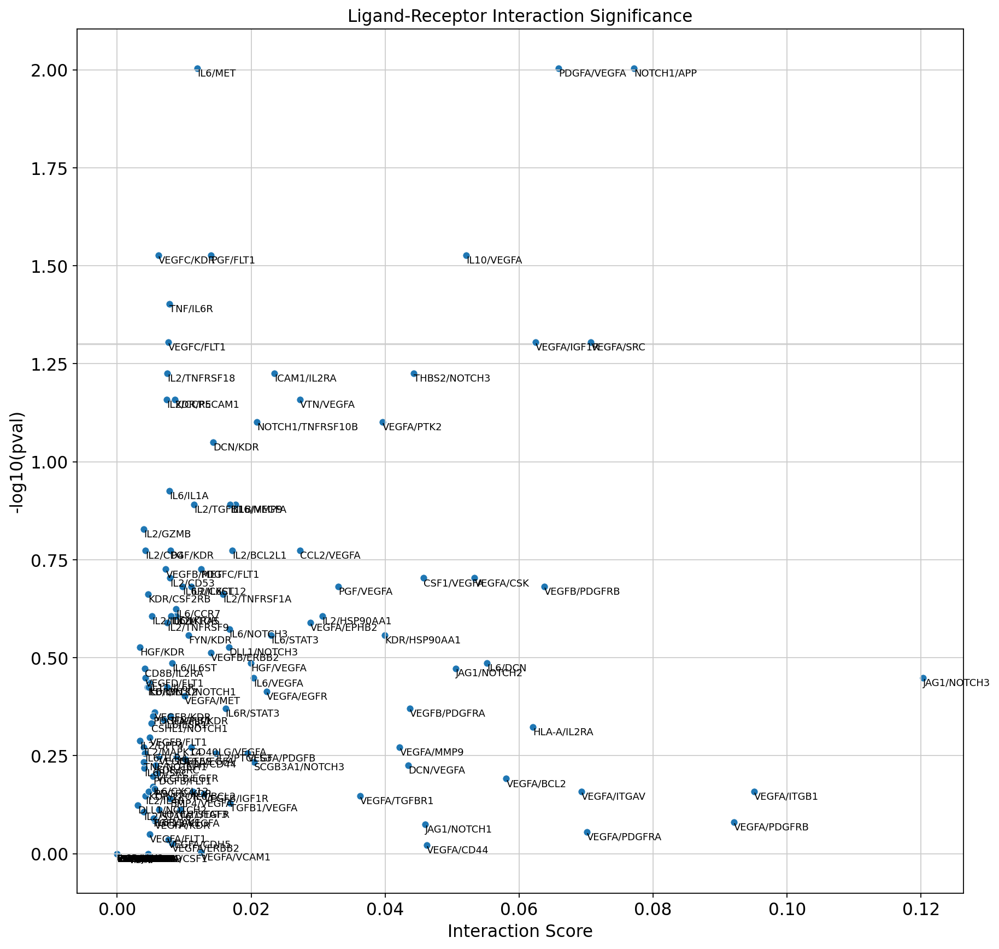

In [94]:
fig, ax = plt.subplots(1, 1, figsize=(13,13))
mb.plot.ligand_receptor_scatter(
    lr_pair_to_score,
    res,
    ax=ax
)